Reading Images and Resizing....
Reading Images and Resizing: DONE
Extracting Features...
Extracting Features: DONE
Matching Features...
Matching Features: DONE
Building Network...


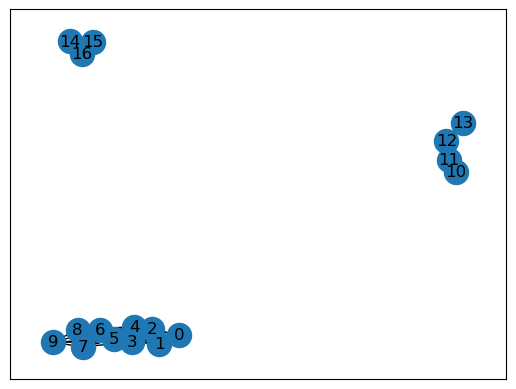

The number of Image Sets is:  3
Finding Significant Matches...
Bundle Adjustment...
Center index is:  [9]
Finding Significant Matches...
Bundle Adjustment...
Center index is:  [2]
Finding Significant Matches...
Bundle Adjustment...
Center index is:  [1]
Building Network: DONE
Building Panorama...


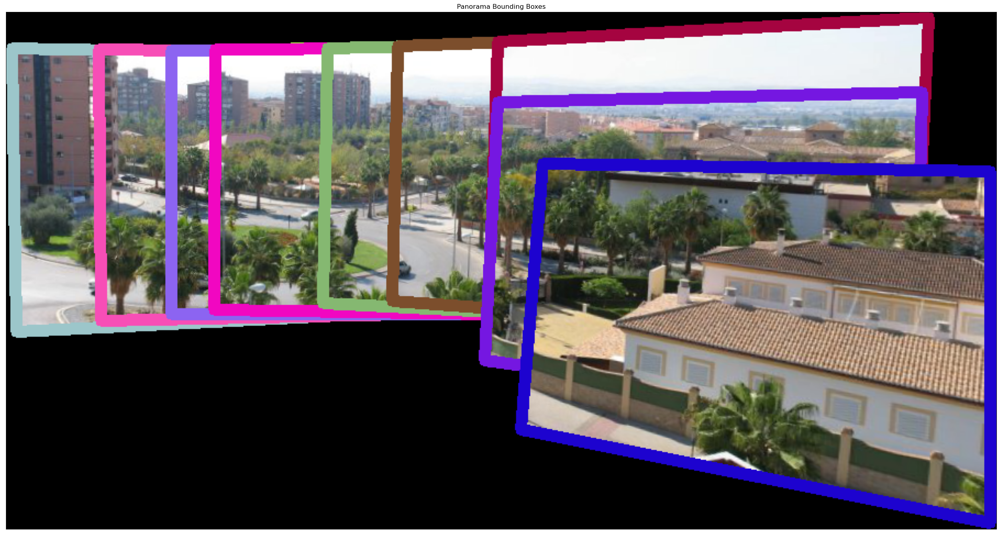

===Starting Gain Compensation===
Removing InProcess Clutter...


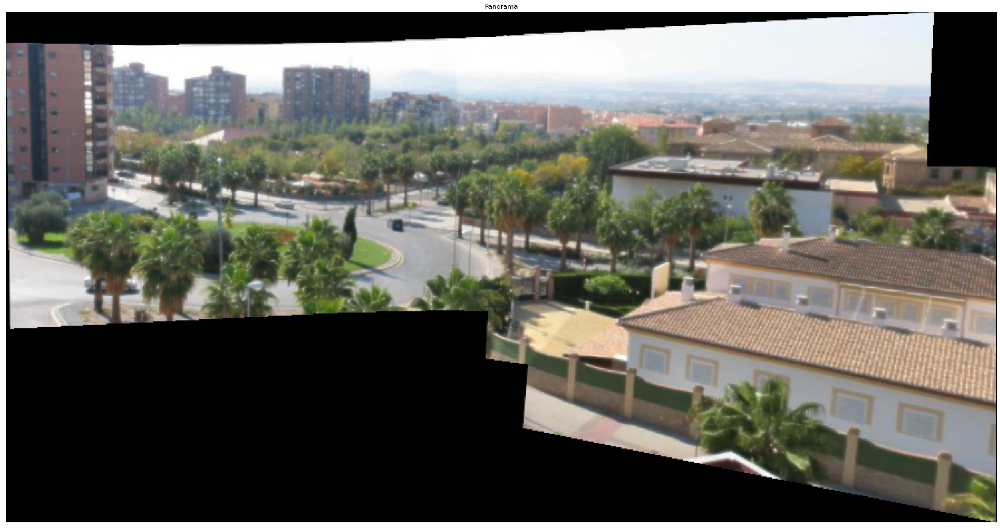

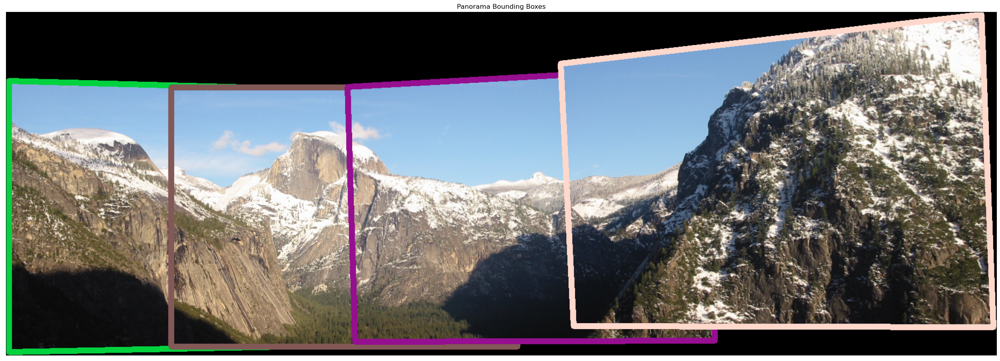

===Starting Gain Compensation===
Removing InProcess Clutter...


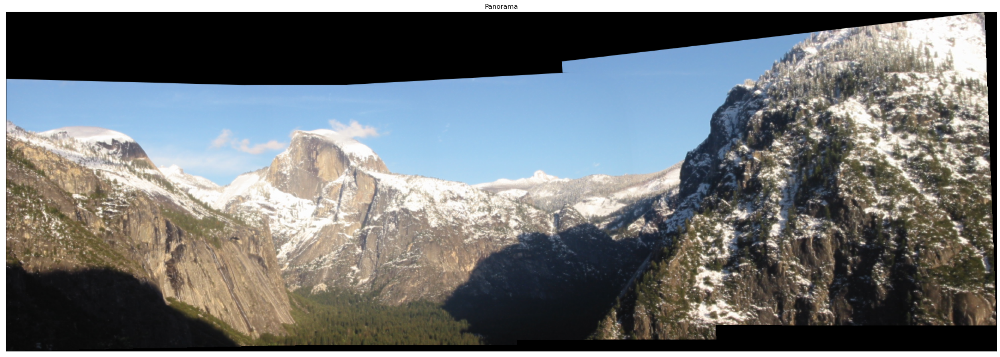

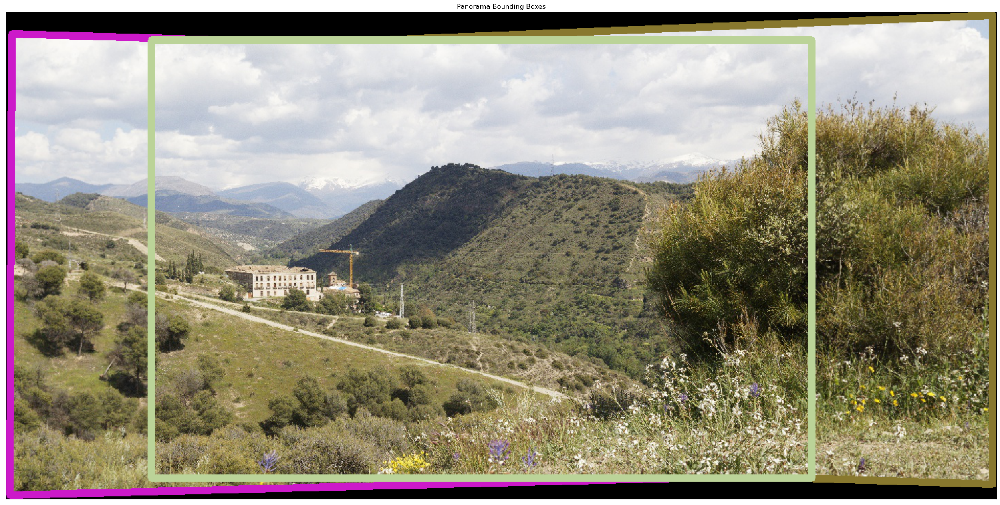

===Starting Gain Compensation===
Removing InProcess Clutter...


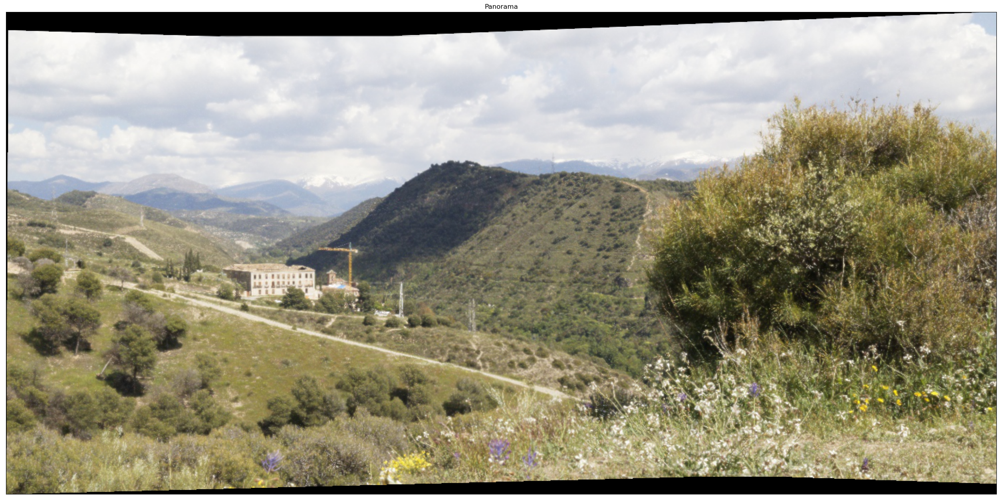

--- 20.53089666366577 seconds ---


In [3]:
"""
-------------------- Steps ------------------------------------------
    0) Image Reading and Resizing (If Neccesary)
    1) Feature Extraction (featureExtraction.py)
    2) Feature Matching
    3) Undirected Graph (Network) Creation
          (Bundle Adjustment + Panorama Identification)
    4) Individual Panorama Rendering
          (Gain Compensation + Muliband Blending)

############################################################################
INPUT VARIABLES: These input variables are used for the entire program. The
                  suggested values are recommended
############################################################################
"""

# ==================== CUSTOM Functions ===============================
import sys, os

import src.imgIO as imgIO # To Read Images
import src.im2spherical as im2spherical # To Convert to Spherical Projected Images
import src.featureProcessing as featureProcessing
import src.config as config # Default Variables
import src.panoramaProcessing as panoramaProcessing
import src.network as network
import time

# --------------------------------------
imageFolder = "images/setSmall"
#       images/setBig has 4 Unordered panoramas
#       images/setSmall has 2 Unordered panoramas
#       images/setSingle has 1 panorama
#       images/setSingle2 has 1 panorama
#       images/setSingle3 has 1 panorama
#       images/setSingle4 has 1 panorama
#       images/setSingle5 has 1 panorama
# --------------------------------------

start_time = time.time()
if __name__ == "__main__":

    # --------------------  Image Input List (Unordered) -------------------------
    # Import Images from current with a subfolder where images are located
    images, imagesColor = imgIO.readBWColor(
        folderName=imageFolder)  # imagesColabBig has 5 panoramas byut takes 4min in google colab (48s in my computer)

    # .....................Step 0: Transfrom Images

    if config.warpType == 'spherical':
        images = (im2spherical.sphericalProjection(images, f=config.f))
        imagesColor = (im2spherical.sphericalProjection(imagesColor, f=config.f))

    # -------------------- Step 1: Feature Extraction ---------------------
    kpComplete, dsComplete = featureProcessing.siftFeatureExtraction(images)

    # -------------------- Step 2: Feature Matching ---------------------
    allMatches, numMatches, homographyMatches = featureProcessing.featureMatching(images, kpComplete, dsComplete)

    # -------------------- Step 3: Undirected Graph (Network) Creation ---------------------
    concomps, finalPanoramaTforms, centerIdx, allCombinedTforms, subTreesIdx, ordering, allRoutes = network.getUndirectedGraph(
        numMatches, homographyMatches, images)

    # -------------------- Step 4: Individual Panorama Rendering ---------------------

    allPanoramas = panoramaProcessing.displayPanorama(finalPanoramaTforms, imagesColor, concomps, centerIdx, allCombinedTforms,
                                   subTreesIdx, ordering, kpComplete, allMatches, numMatches)
    print("--- %s seconds ---" % (time.time() - start_time))


